## Import

In [2]:
import pandas as pd
import scvelo as scv
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import scanpy as sc
import scipy.sparse
import os
import sys
import scanpy.external as sce
from importlib import reload
import numpy as np
import pickle
import gseapy
import os
import bbknn
import sys
import shutil
import scrublet as scr
import ipywidgets as widgets
import wot
import copy
import re
import seaborn as sns
import math
sc.settings.verbosity = 0  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.set_figure_params(scanpy=True, dpi=150, dpi_save=500, frameon=False, vector_friendly=True, fontsize=14, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True)

In [3]:
import matplotlib.pyplot as plt
import matplotlib.colors
baguette = matplotlib.colors.LinearSegmentedColormap.from_list("", ["whitesmoke","dodgerblue","blue"])

In [4]:
Progenitors = '#1f77b4'
BrownAdipocytes ='#ff7f0e'
ConnectiveTissue ='#279e68'
Dermis ='#d62728'
DermisPrecursors ='#c45b41'
Bone= '#aa40fc'
BrownAdipocytesPrecursors ='#8c564b'
SmoothMuscle= '#e377c2'
Cartilage ='#b5bd61'
CartilagePrecursors= '#8ebf84'
Tendon ='#17becf'
Blood ='#aec7e8'

SkeletalMuscle='#78295f'
Neuro='#979fbd'

## Day 20

In [20]:
adata = sc.read('datasets/human_culture_day_20_processed.h5ad')

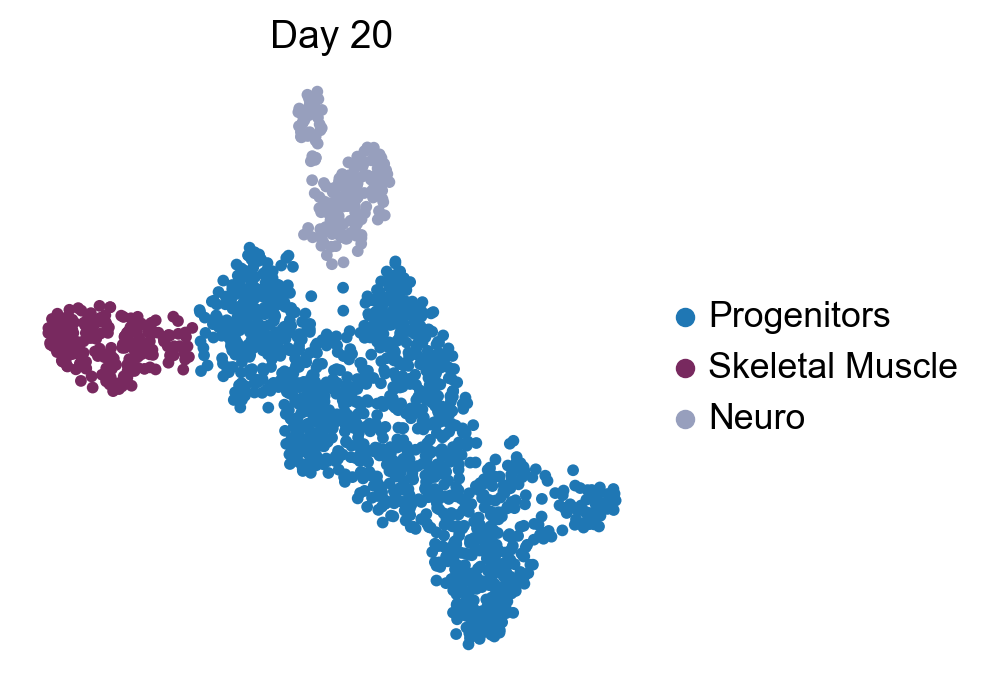

In [236]:
sc.pl.umap(adata, color=['leiden'], title='Day 20', save='human_culture_day_20.pdf',
          palette=[Progenitors,SkeletalMuscle,Neuro])

In [113]:
adata.obs.leiden.cat.reorder_categories(['Progenitors', 'Skeletal Muscle', 'Neuro'], inplace=True)

In [114]:
adata.uns['leiden_colors'] = [Progenitors, SkeletalMuscle,Neuro]

In [115]:
markers_final = ['PDGFRA', 'HIC1', 'EBF2', 'GATA6', 'PPARG', 'CEBPA', 'CIDEA', 'UCP1']

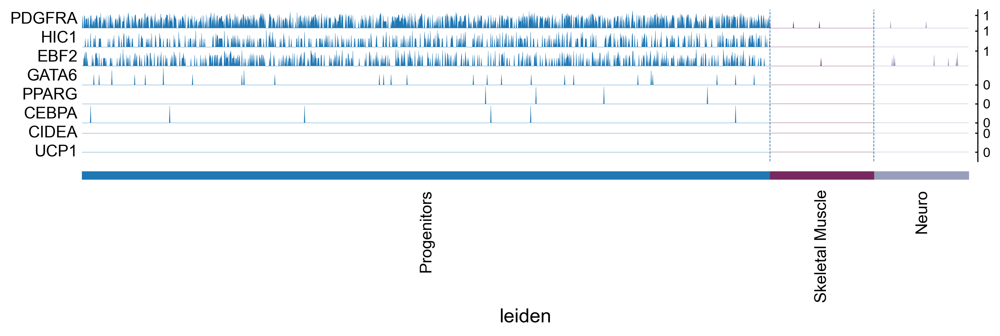

In [116]:
sc.pl.tracksplot(adata, markers_final, groupby='leiden', save='coexpression_curated_marker_genes_tracksplot_human_day20.pdf', title='Human')

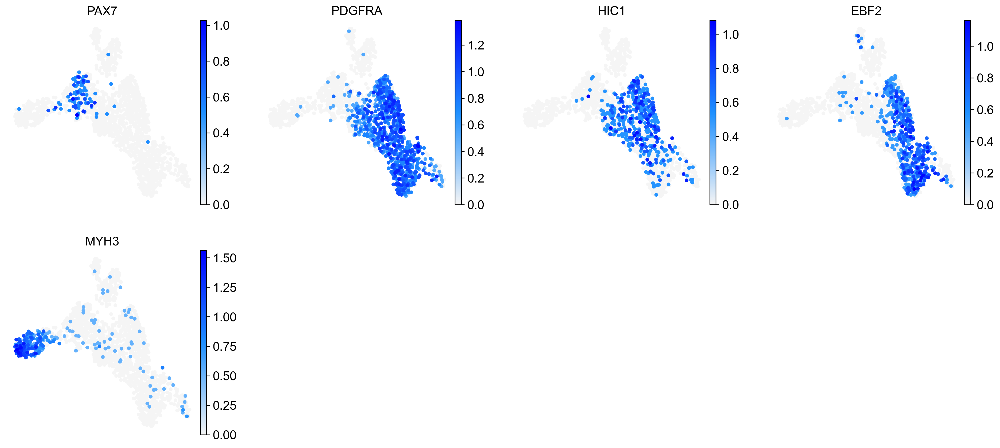

In [21]:
sc.pl.umap(adata, color=['PAX7', 'PDGFRA', 'HIC1', 'EBF2', 'MYH3'], color_map=baguette, save='human_20_curatedgenes_UMAP')

## Day 40

In [5]:
adata=sc.read('datasets/human_culture_day_40_processed.h5ad')

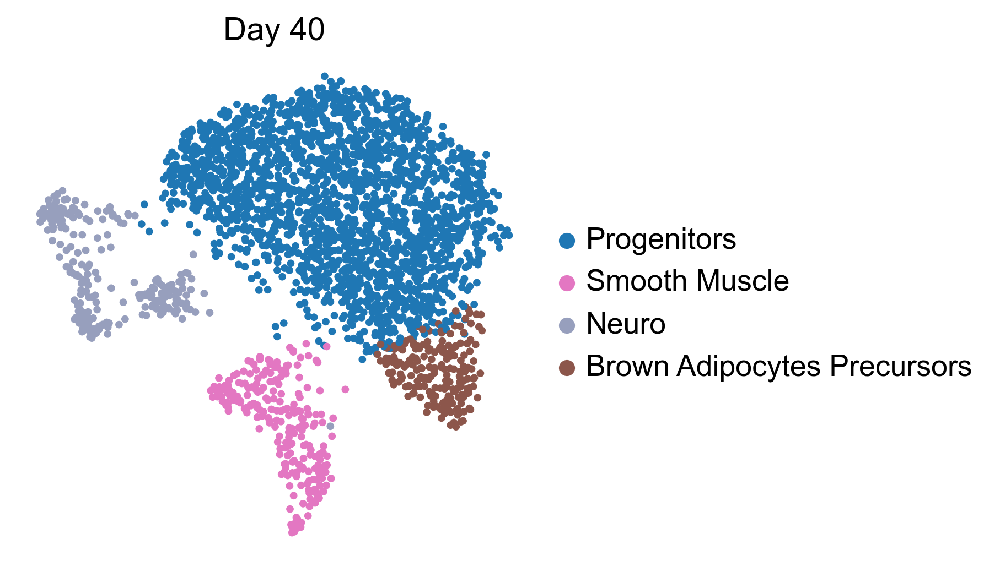

In [6]:
sc.pl.umap(adata, color=['clusters_human'], title='Day 40', save='human_culture_day_40.pdf',
          palette=[Progenitors,SmoothMuscle,Neuro,BrownAdipocytesPrecursors])

In [104]:
adata.obs.leiden.cat.reorder_categories(['Progenitors', 'Brown Adipocytes Precursors', 'Neuro', 'Smooth Muscle'], inplace=True)

In [107]:
adata.uns['leiden_colors'] = [Progenitors, BrownAdipocytesPrecursors,Neuro, SmoothMuscle]

In [108]:
markers_final = ['PDGFRA', 'HIC1', 'EBF2', 'GATA6', 'PPARG', 'CEBPA', 'CIDEA', 'UCP1']

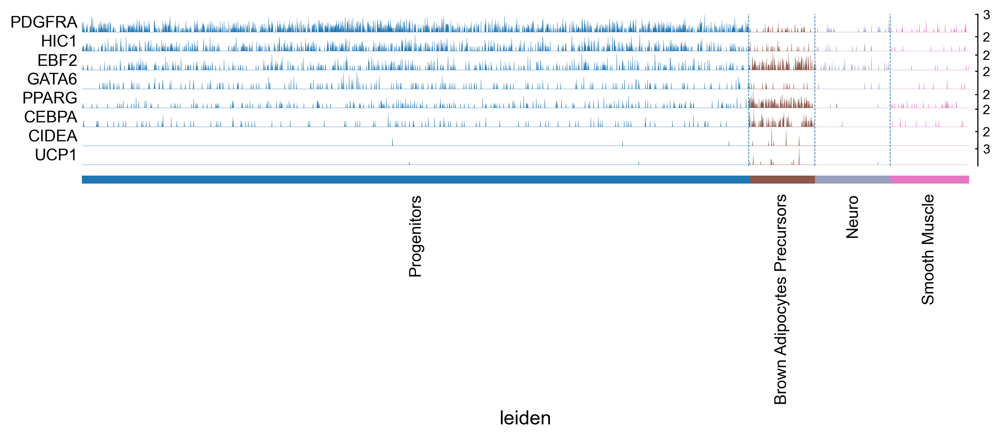

In [110]:
sc.pl.tracksplot(adata, markers_final, groupby='leiden', save='coexpression_curated_marker_genes_tracksplot_human_day40.pdf', title='Human')

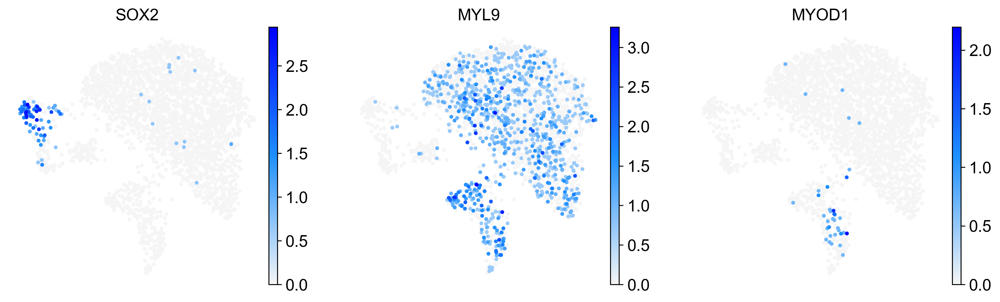

In [115]:
sc.pl.umap(adata, color=['SOX2', 'MYL9', 'MYOD1'], color_map=baguette, save='human_40_curatedgenes_UMAP')

## Day 60

In [35]:
adata=sc.read('datasets/human_culture_day_60_processed.h5ad')

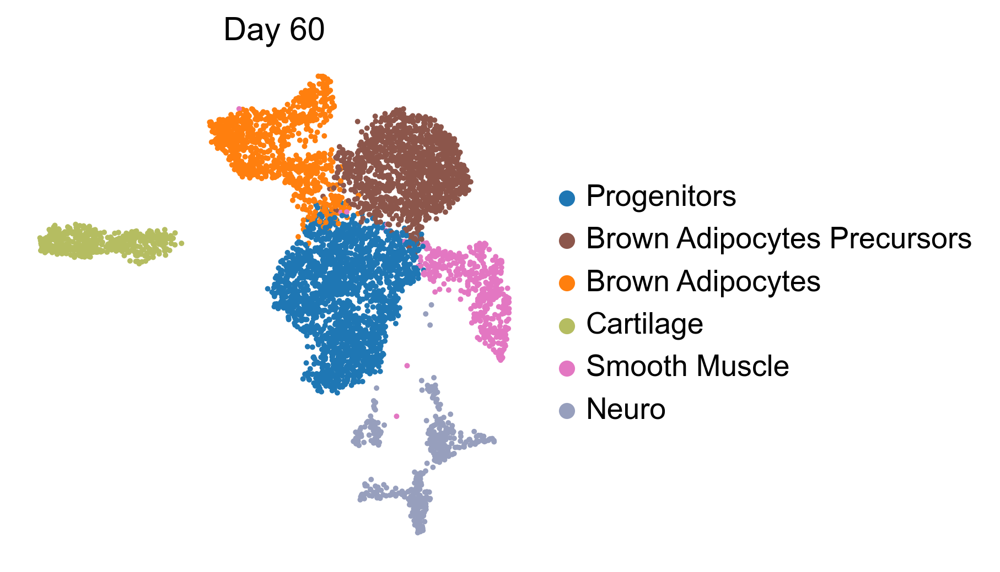

In [36]:
sc.pl.umap(adata, color=['leiden'], title='Day 60', save='human_culture_day_60.pdf',
          palette=[Progenitors,BrownAdipocytesPrecursors,BrownAdipocytes,Cartilage,SmoothMuscle,Neuro])

In [37]:
adata.obs.clusters_human.cat.reorder_categories(['Progenitors', 'Brown Adipocytes Precursors', 'Brown Adipocytes', 'Cartilage', 'Neuro', 'Smooth Muscle'], inplace=True)

In [38]:
markers_final = ['PDGFRA', 'HIC1', 'EBF2', 'GATA6', 'PPARG', 'CEBPA', 'CIDEA', 'UCP1']

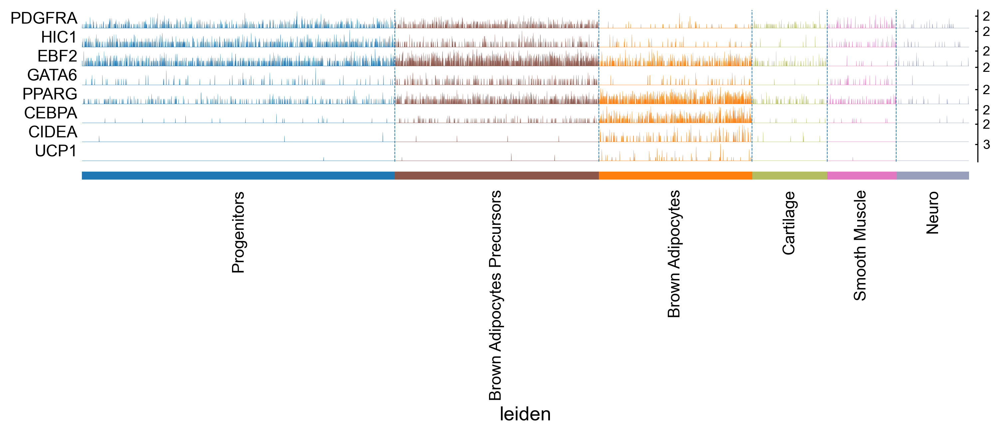

In [40]:
sc.pl.tracksplot(adata, markers_final, groupby='leiden', save='coexpression_curated_marker_genes_tracksplot_human_day60.pdf', title='Human')

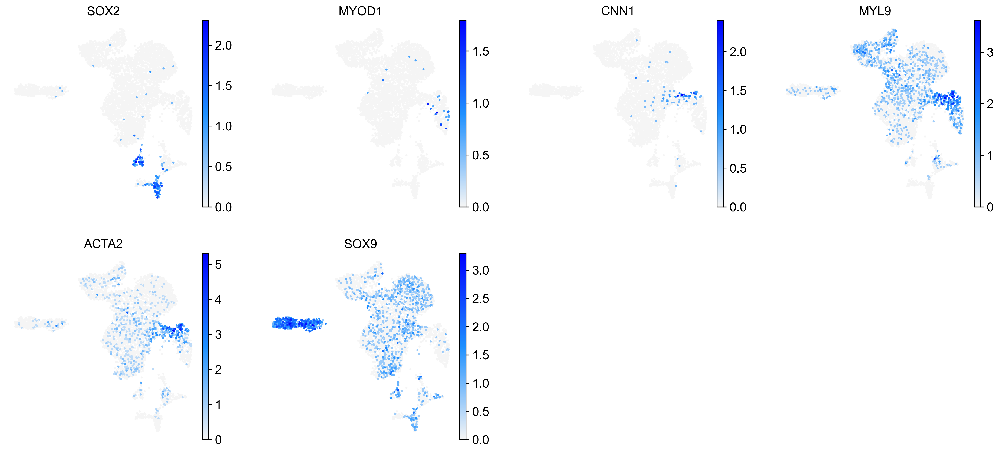

In [130]:
sc.pl.umap(adata, color=['SOX2', 'MYOD1', 'CNN1', 'MYL9', 'ACTA2', 'SOX9'], color_map=baguette, save='human_60_curatedgenes_UMAP')

## Day culture Merge

In [171]:
adata=sc.read('datasets/human_all_timepoints_processed.h5ad')

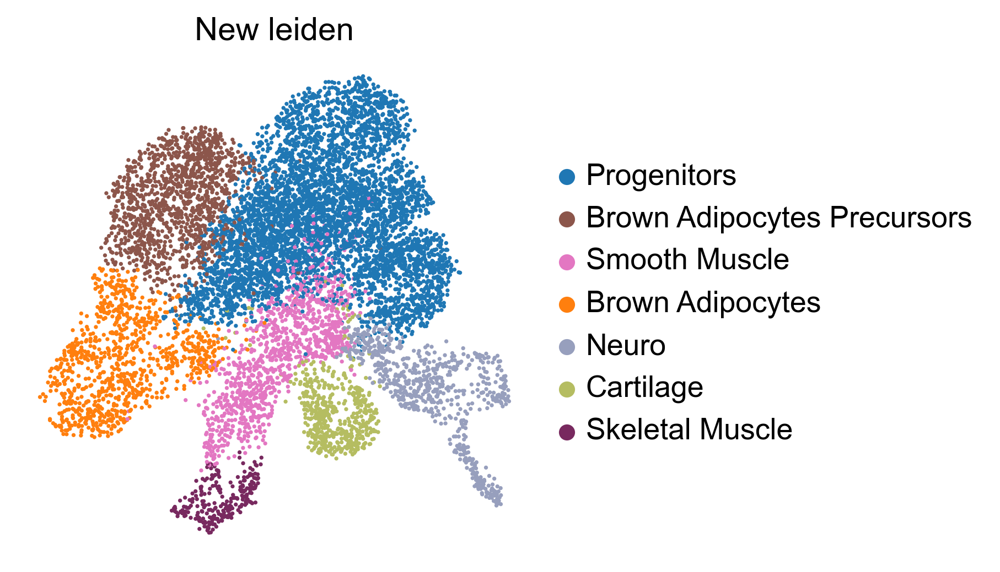

In [40]:
sc.pl.umap(adata, color=['leiden'], title='New leiden', save='human_new_leiden_total.pdf',palette=[Progenitors,BrownAdipocytesPrecursors,SmoothMuscle,BrownAdipocytes,Neuro,Cartilage,SkeletalMuscle])

In [39]:
markers_2 = ['PDGFRA', 'HIC1', 'EBF2', 'MYOD1', 'MYH3', 'ACTA2', 'MYL9', 'CEBPA', 'SOX2']

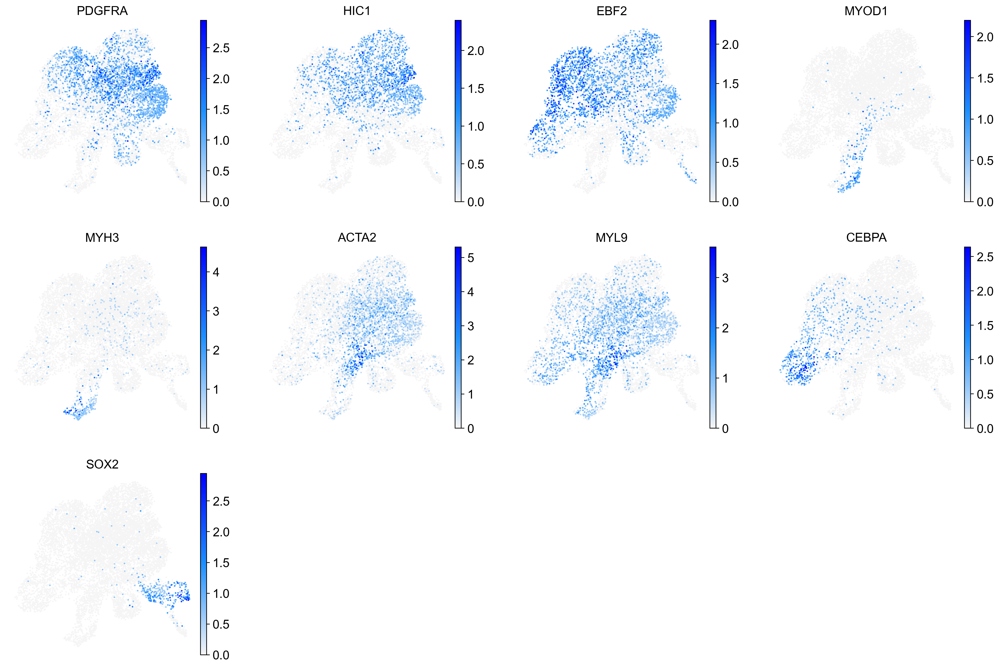

In [40]:
sc.pl.umap(adata, color=markers_2, color_map=baguette, save='human_all_timepoints_UMAP_curated')

In [6]:
markers_2 = ['PDGFRA', 'HIC1', 'EBF2', 'MYOD1', 'MYH3', 'ACTA2', 'MYL9', 'CEBPA', 'SOX2']

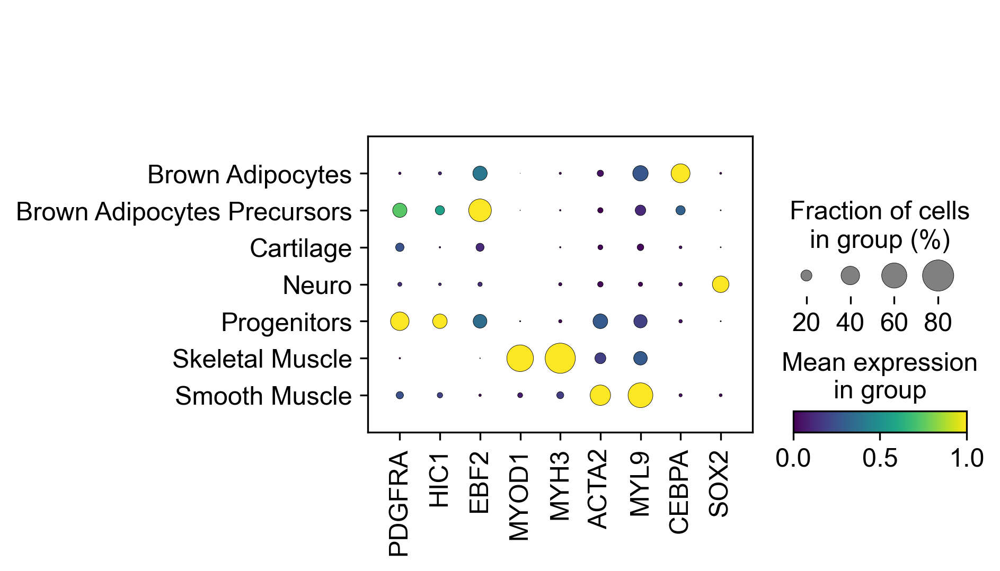

In [41]:
sc.pl.dotplot(adata, var_names=markers_2 ,groupby='clusters_human',
              return_fig=False,color_map='viridis', standard_scale='var',
               use_raw=False, swap_axes=False, save='human_all_timepoints_dotplot_leiden_mice_subcluster.pdf', 
              title='')

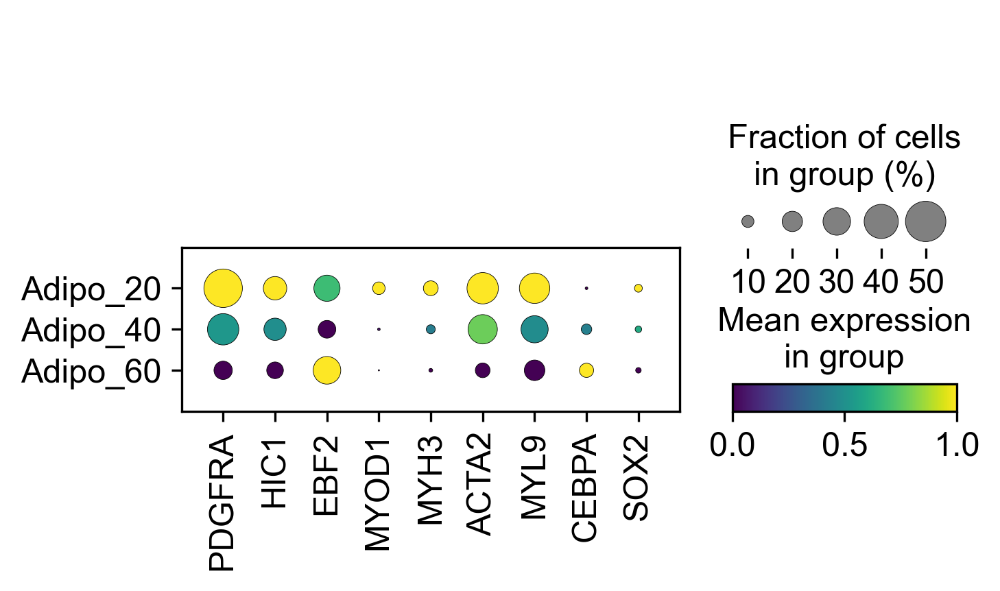

In [10]:
sc.pl.dotplot(adata, var_names=markers_2 ,groupby='day',
              return_fig=False,color_map='viridis', standard_scale='var',
               use_raw=False, swap_axes=False, save='human_all_timepoints_dotplot_time_mice_subcluster.pdf', 
              title='')

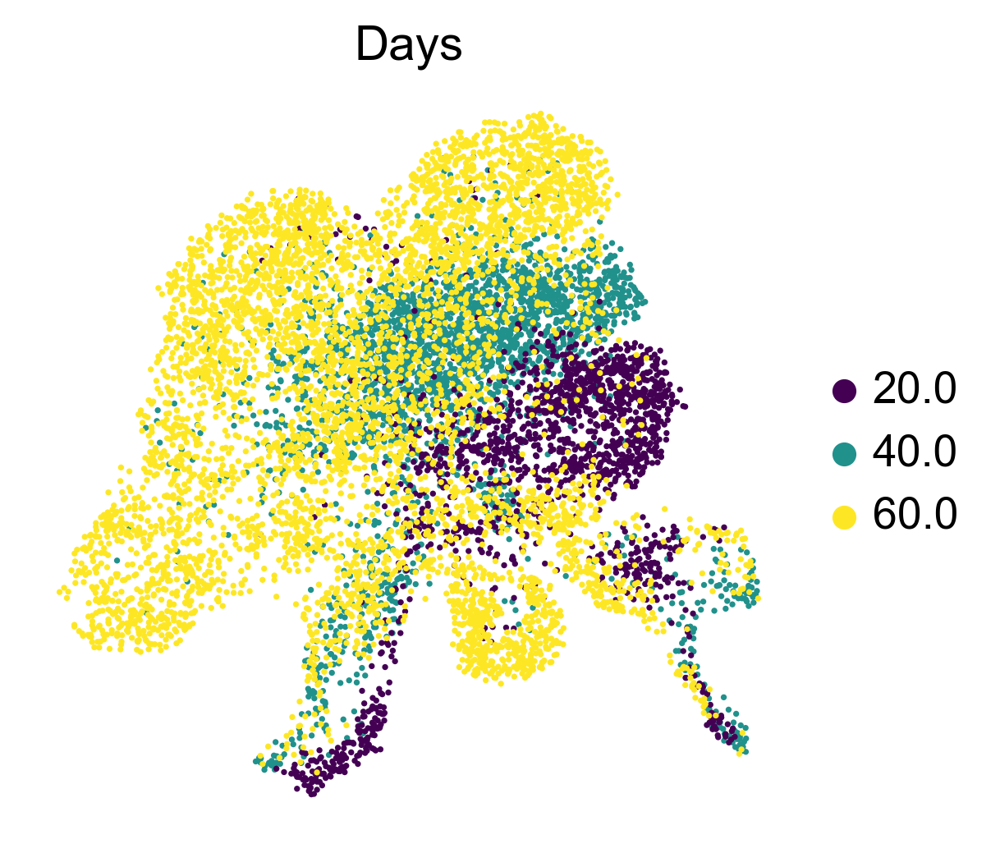

In [49]:
sc.pl.umap(adata, color=['day'], title='Days', palette='viridis', save='human_time_total.pdf')

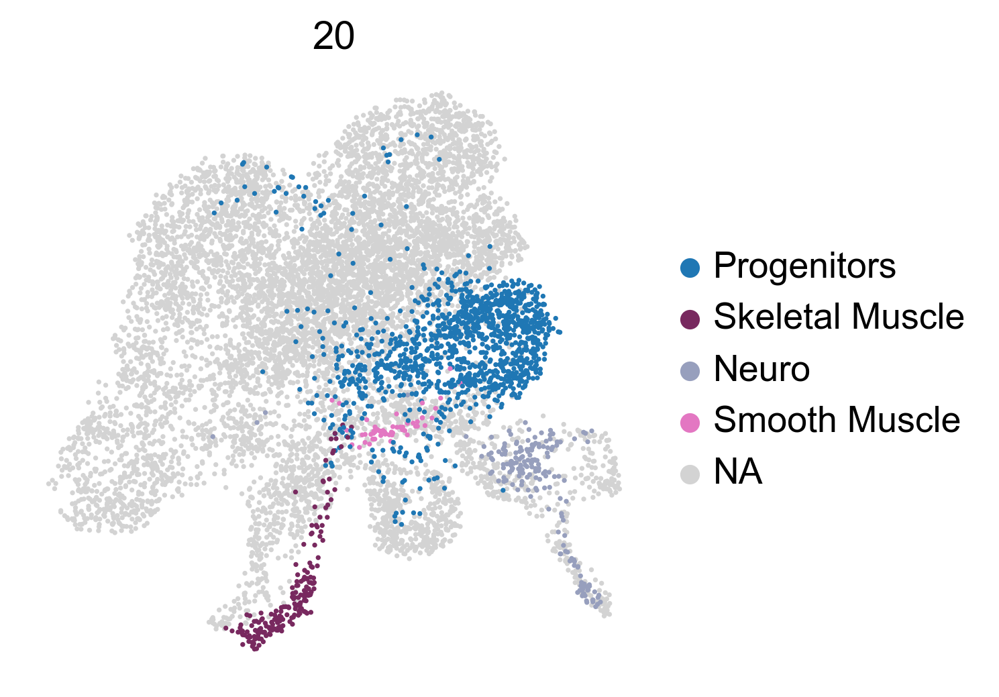

In [114]:
sc.pl.umap(adata, color=['leiden_d24'], title='20', save='human_leiden_day24total.pdf',
          palette=[Progenitors,SkeletalMuscle,Neuro,SmoothMuscle])

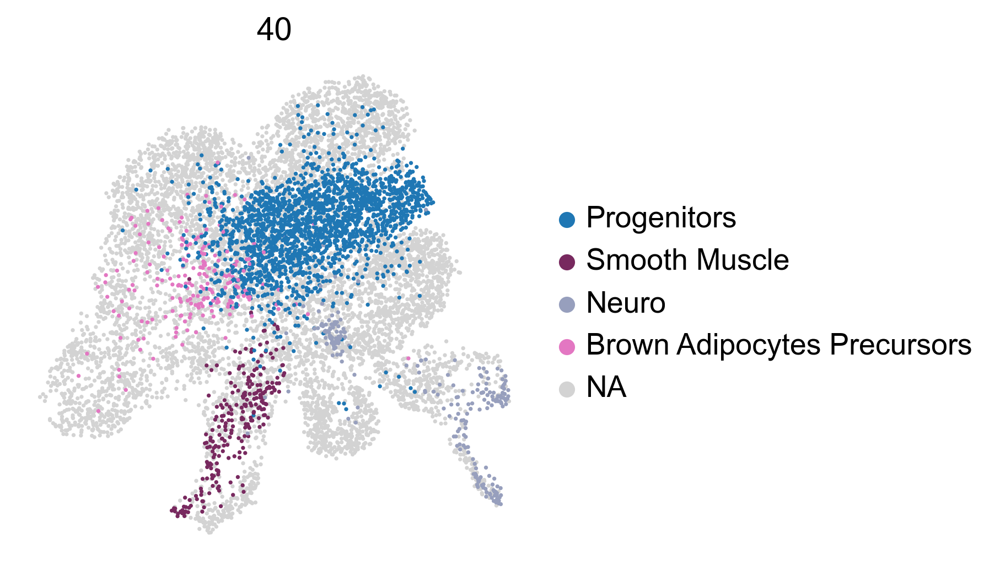

In [115]:
sc.pl.umap(adata, color=['leiden_d40'], title='40', save='human_leiden_day40total.pdf',
          palette=[Progenitors,SkeletalMuscle,Neuro,SmoothMuscle])

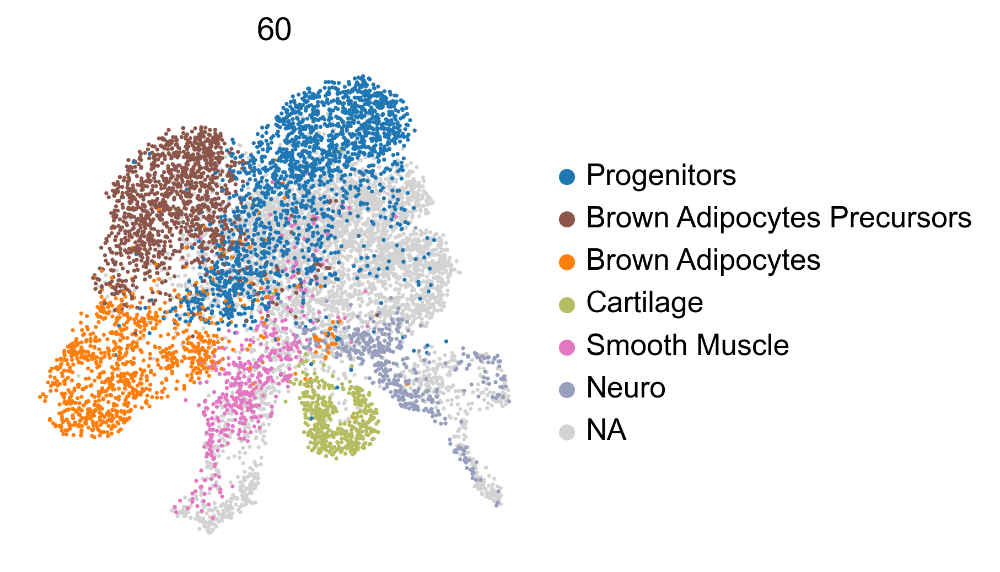

In [116]:
sc.pl.umap(adata, color=['leiden_d60'], title='60', save='human_leiden_day60total.pdf',
          palette=[Progenitors,BrownAdipocytesPrecursors,BrownAdipocytes,Cartilage,SmoothMuscle,Neuro])

In [76]:
adata.obs.clusters_human.cat.reorder_categories(['Progenitors', 'Brown Adipocytes Precursors', 'Brown Adipocytes', 'Cartilage', 'Neuro', 'Skeletal Muscle', 'Smooth Muscle'], inplace=True)

In [77]:
adata.uns['clusters_human_colors'] = [Progenitors, BrownAdipocytesPrecursors, BrownAdipocytes, Cartilage,Neuro, SkeletalMuscle, SmoothMuscle]

In [44]:
markers_final = ['PDGFRA', 'HIC1', 'EBF2', 'GATA6', 'PPARG', 'CEBPA', 'CIDEA', 'UCP1']

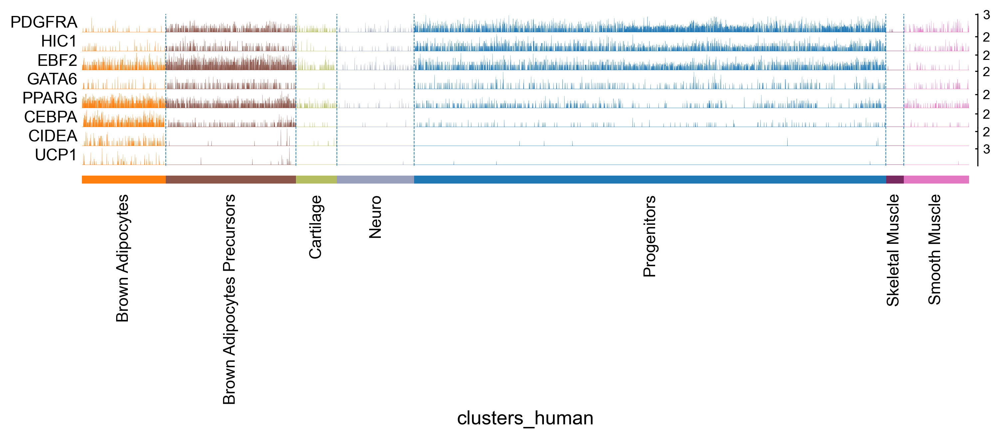

In [48]:
sc.pl.tracksplot(adata, markers_final, groupby='clusters_human', save='coexpression_curated_marker_genes_tracksplot_human.pdf', title='Human')

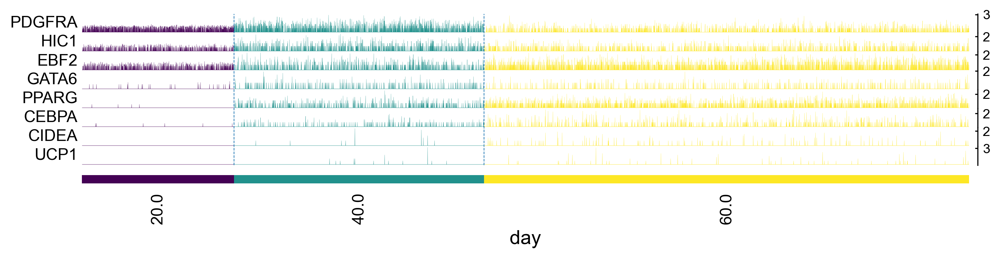

In [80]:
sc.pl.tracksplot(adata, markers_final, groupby='day', save='time_coexpression_curated_marker_genes_tracksplot_human.pdf', title='Mice')

### UCP1

In [117]:
adata_subcluter = sc.AnnData(X = adata.raw.X, var = adata.raw.var, obs = adata.obs)
sum(adata_subcluter[:, ['UCP1']].X.toarray() > 0)[0]

66

In [118]:
d = {'Adipo_D20': [0], 'Adipo_D40': [12], 'Adipo_D60': [54]}
df = pd.DataFrame(data=d, index=['Number of UCP1+ cells'])
df = df.T
df

,Number of UCP1+ cells
Adipo_D20,0
Adipo_D40,12
Adipo_D60,54


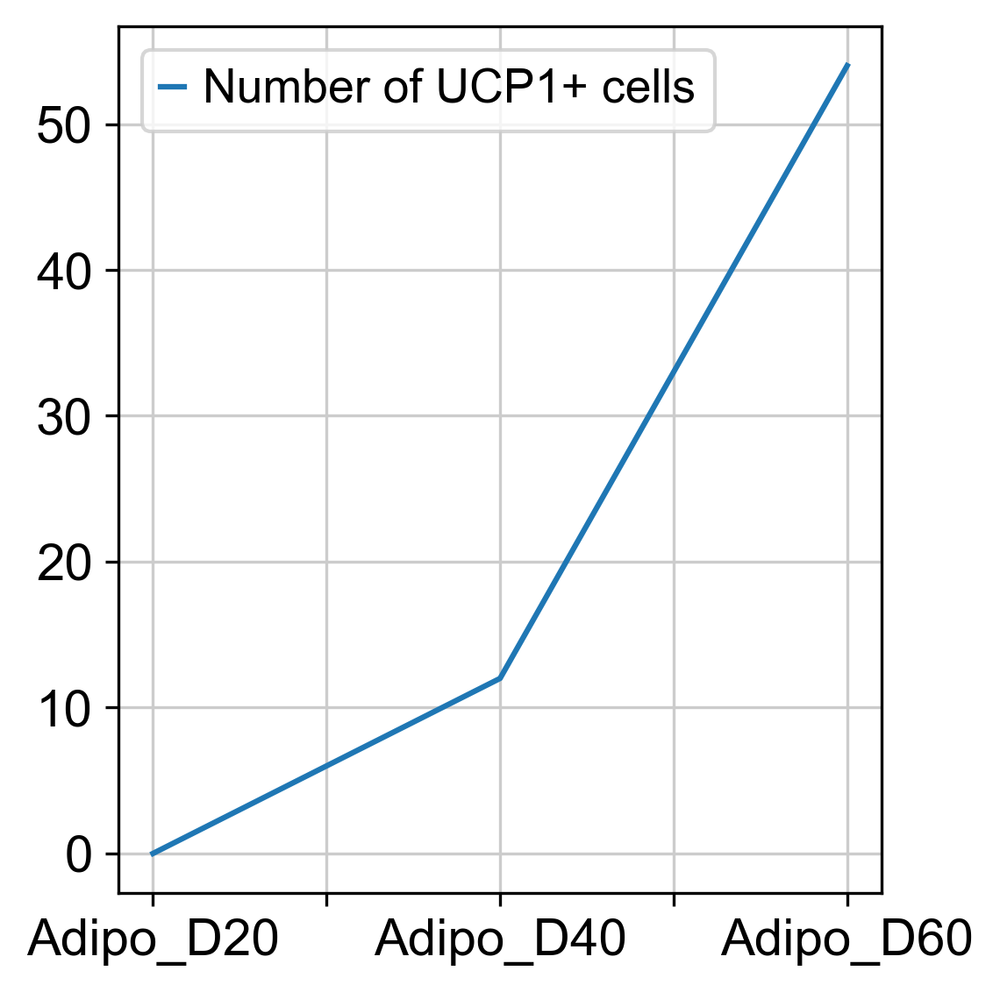

In [119]:
ax = df.plot()
fig = ax.get_figure()
fig.tight_layout()
fig.savefig('figures/UCP1.pdf')

In [6]:
adata=sc.read('datasets/human_culture_trajectory.h5ad')

In [140]:
adata_subcluter = adata[:, ['GATA6']]
sc.pp.filter_cells(adata_subcluter, min_genes=1)

Trying to set attribute `.obs` of view, copying.


In [141]:
sc.pp.filter_cells(adata_subcluter, min_counts =1 )
adata_subcluter.shape

(106, 1)

In [146]:
adata_subcluter.obs.clusters_human.cat.reorder_categories(['Progenitors', 'Brown Adipocytes Precursors', 'Brown Adipocytes', 'Neuro', 'Smooth Muscle'], inplace=True)

In [147]:
adata_subcluter.uns['clusters_human_colors'] = [Progenitors, BrownAdipocytesPrecursors, BrownAdipocytes,Neuro, SmoothMuscle]

In [ ]:
import copy
cluster_key="clusters_human"
sample_key="day"
adata.obs['hey'] = 1
adata_tmp = adata_subcluter.copy()

import scanpy_cluster_proportions_v2
df2 = scanpy_cluster_proportions_v2.get_cluster_number(adata_tmp,cluster_key=sample_key, sample_key=cluster_key)
cluster_props = df2

In [ ]:
cluster_props

day,40.0,60.0
clusters_human,,
Progenitors,34,19
Brown Adipocytes Precursors,0,33
Brown Adipocytes,0,12
Neuro,0,1
Smooth Muscle,1,6


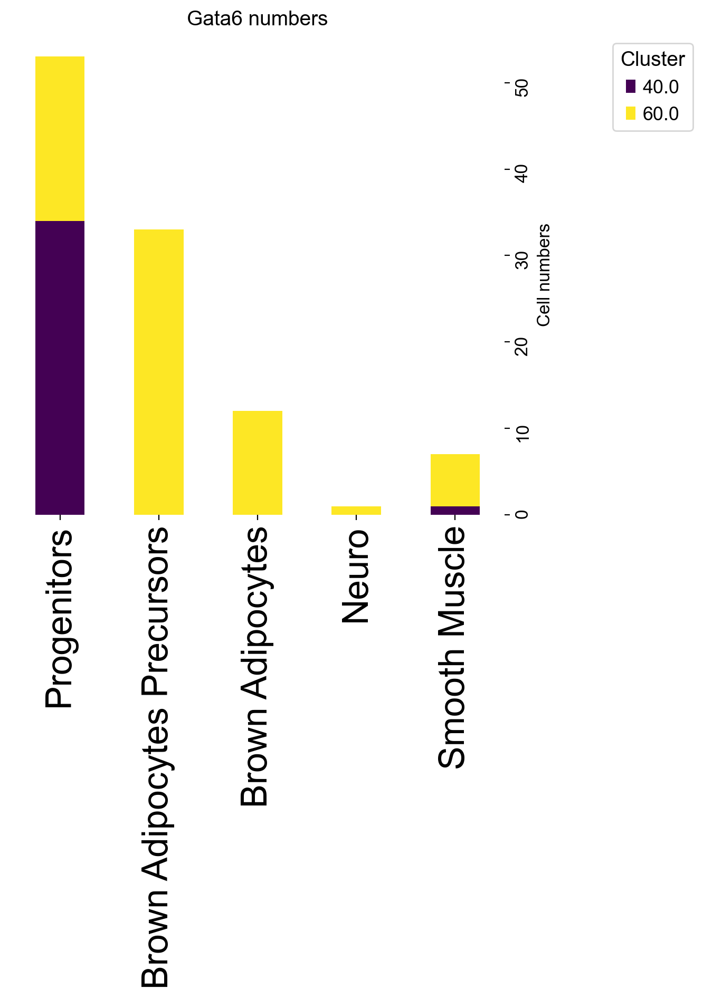

In [ ]:
cluster_palette=['#440154', '#21918c', '#fde725']
xlabel_rotation=90
taillepolice=12

fig, ax = plt.subplots(dpi=100)
fig.patch.set_facecolor("white")

#cluster_palette = palette=['tab:green', 'tab:orange', 'tab:red', 'tab:blue', 'tab:purple']

cmap=None

if cluster_palette is not None:
    cmap = sns.palettes.blend_palette(
        cluster_palette, 
        n_colors=len(cluster_palette), 
        as_cmap=True)

cluster_props.plot(
    kind="bar",
    stacked=True, 
    ax=ax, 
    legend=False,
    colormap=cmap,
    fontsize='xx-large'
    
)

ax.legend(bbox_to_anchor=(1.4, 1), frameon=True, title="Cluster")
sns.despine(fig, ax, left=True, bottom=True)
ax.tick_params(axis="y", rotation=xlabel_rotation, labelsize=taillepolice)
ax.set_xlabel('')
ax.set_ylabel("Cell numbers", fontsize=12)
ax.yaxis.set_label_position("right")
ax.yaxis.tick_right()
fig.set_size_inches(6,6)
plt.yticks(rotation = 90)
ax.grid(False)
plt.title("Gata6 numbers")

fig.savefig('figures/Gata6_barplot_human.pdf', bbox_inches='tight')

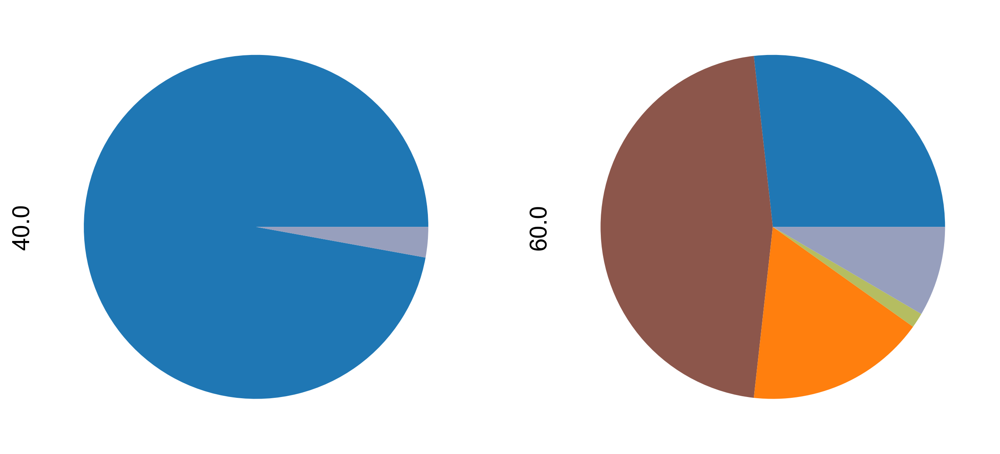

In [155]:
df2.plot.pie(subplots=True, figsize=(10, 10), legend=False, labels=None, colors=[Progenitors, BrownAdipocytesPrecursors, BrownAdipocytes, Cartilage,Neuro, SkeletalMuscle, SmoothMuscle])
plt.savefig(fname="figures/pieplotGATA6_clusters_proportions_human.pdf")

### Proportions

In [120]:
cluster_key="clusters_human"
sample_key="day"
adata_tmp = adata.copy()


import scanpy_cluster_proportions_v2
cluster_props = scanpy_cluster_proportions_v2.get_cluster_proportions(adata_tmp,cluster_key=cluster_key, sample_key=sample_key)

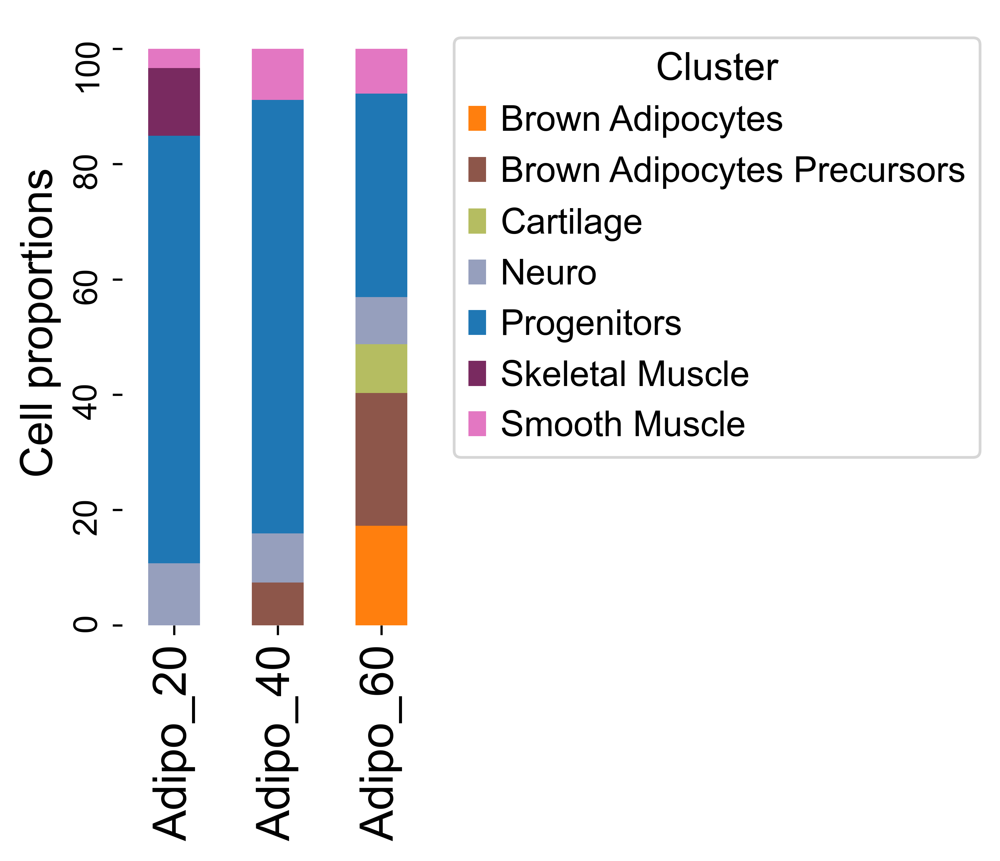

In [121]:
cluster_palette=[BrownAdipocytes,BrownAdipocytesPrecursors,Cartilage,Neuro,Progenitors,SkeletalMuscle,SmoothMuscle]
xlabel_rotation=90
taillepolice=12

fig, ax = plt.subplots(dpi=300)
fig.patch.set_facecolor("white")

cmap = None
if cluster_palette is not None:
    cmap = sns.palettes.blend_palette(
        cluster_palette, 
        n_colors=len(cluster_palette), 
        as_cmap=True)

cluster_props.plot(
    kind="bar",
    stacked=True, 
    ax=ax, 
    legend=False,
    colormap=cmap,
    fontsize='large'
)

ax.legend(bbox_to_anchor=(1.01, 1), frameon=True, title="Cluster")
sns.despine(fig, ax, left=True, bottom=True)
ax.tick_params(axis="y", rotation=xlabel_rotation, labelsize=taillepolice)
ax.set_xlabel('')
ax.set_ylabel("Cell proportions", fontsize=16)
ax.yaxis.set_label_position("left")
ax.yaxis.tick_left()
fig.set_size_inches(2,4)
plt.yticks(rotation = 90)
ax.grid(False)
plt.savefig('figures/barplot_human_all_timepoints.pdf', bbox_inches = 'tight')

In [122]:
markers = ['PDGFRA','HIC1','CD34','DPP4','EN1','CD34','LY6H','PI16','EBF2','GATA6','PPARG','PRDM16','CEBPA','CIDEA','UCP1']

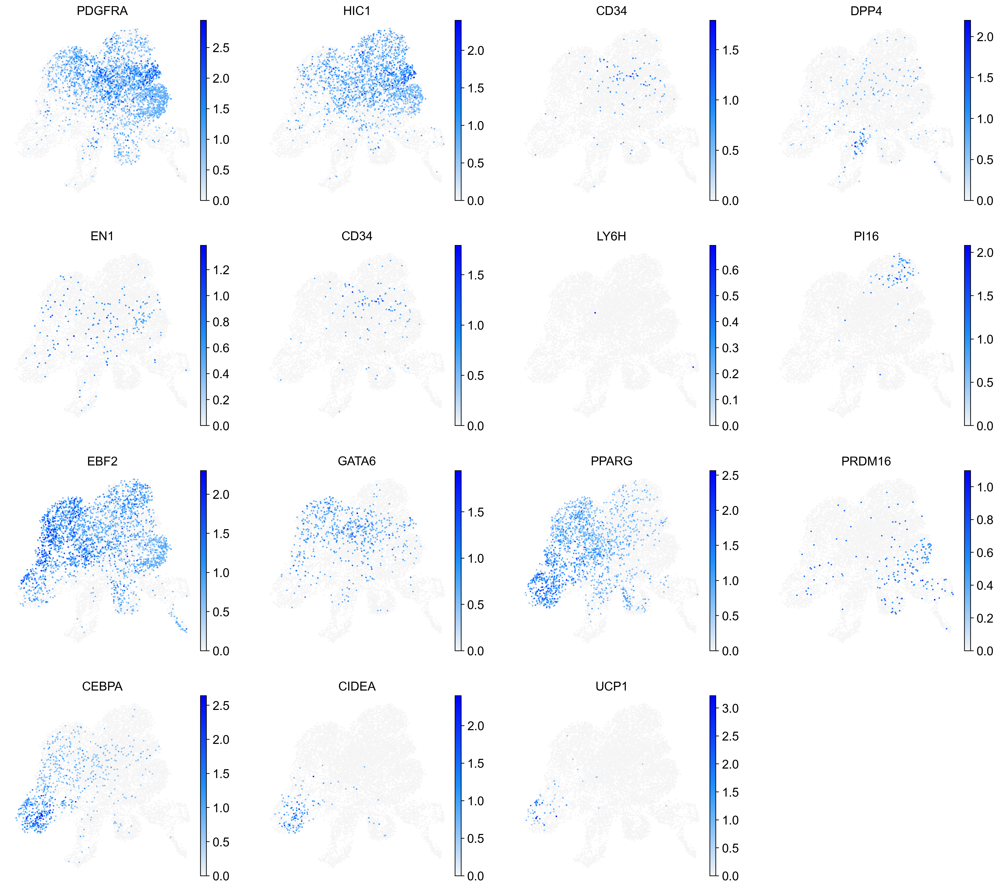

In [123]:
sc.pl.umap(adata, color=markers, color_map=baguette, save='curated_human genes')

## Trajectory

In [172]:
import sys

if "google.colab" in sys.modules:
    !pip install -q git+https://github.com/theislab/cellrank@dev#egg=cellrank[external,krylov]

import matplotlib.pyplot as plt
import scvelo as scv
import scanpy as sc
import cellrank as cr
import wot

# import CellRank kernels and estimators
from cellrank.external.kernels import WOTKernel
from cellrank.tl.kernels import ConnectivityKernel
from cellrank.tl.estimators import GPCCA

# set verbosity levels
cr.settings.verbosity = 2
scv.settings.verbosity = 3

# figure settings
scv.settings.set_figure_params(
    "scvelo", dpi_save=400, dpi=80, transparent=True, fontsize=20, color_map="viridis")

In [173]:
sc.settings.verbosity = 0  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=500, frameon=False, vector_friendly=True, fontsize=14, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True)

In [174]:
adata = sc.AnnData(adata.raw.X,obs=adata.obs,var=adata.raw.var,uns=adata.uns,obsm=adata.obsm,obsp=adata.obsp,layers=adata.layers)

In [175]:
adata.obs['day'] = adata.obs['day'].replace(['Adipo_20'],20)
adata.obs['day'] = adata.obs['day'].replace(['Adipo_40'],40)
adata.obs['day'] = adata.obs['day'].replace(['Adipo_60'],60)

In [176]:
wk = WOTKernel(adata, time_key="day")

In [177]:
wk.compute_initial_growth_rates(organism="human", key_added="growth_rate_init")

Computing `proliferation` scores
Computing `apoptosis` scores


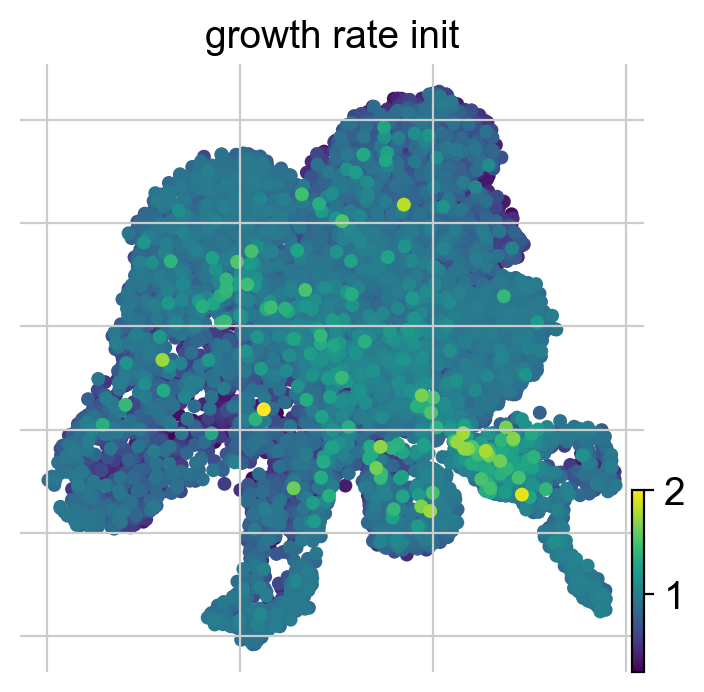

In [178]:
scv.pl.scatter(
    adata, c="growth_rate_init", legend_loc="right", basis="X_umap", s=100
)

In [179]:
wk.compute_transition_matrix(
    growth_iters=3, growth_rate_key="growth_rate_init", last_time_point="connectivities",
)

Computing transition matrix using Waddington optimal transport
Using default cost matrices
Computing transport maps for `2` time pairs


  0%|          | 0/2 [00:00<?, ?time pair/s]

    Finish (0:01:19)
Computing transition matrix based on `adata.obsp['connectivities']`
    Finish (0:00:00)
Using `threshold=0.0006099221652676583`
    Finish (0:01:23)


<WOTKernel>

Simulating `10000` random walks of maximum length `500`


  0%|          | 0/10000 [00:00<?, ?sim/s]

    Finish (0:01:09)
Plotting random walks


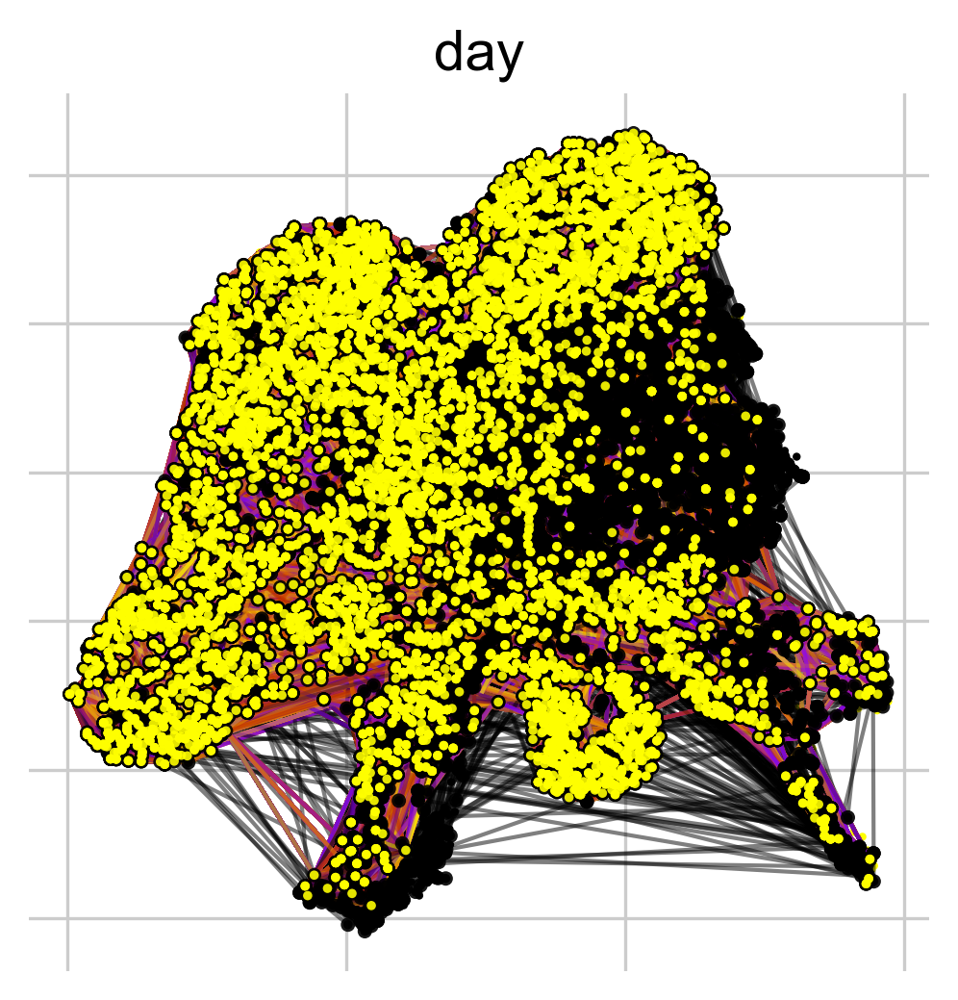

In [180]:
wk.plot_random_walks(
    n_sims=10000,
    max_iter=500,
    start_ixs={"day": 0.0},
    basis="X_umap",
    c="day",
    legend_loc="none",
    linealpha=0.5,
    dpi=150,
    n_jobs=-1
)


Computing flow from `Progenitors` into `5` cluster(s) in `2` time points
Plotting flow from `Progenitors` into `4` cluster(s) in `2` time points


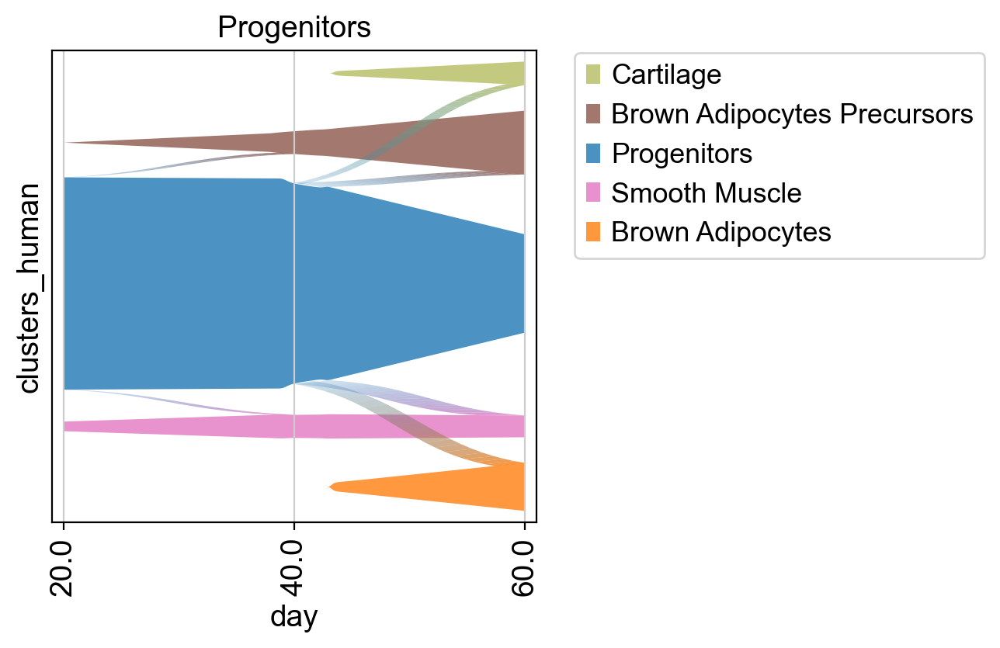

In [181]:
ax = wk.plot_single_flow(
    cluster_key="clusters_human",
    time_key="day",
    cluster="Progenitors",
    min_flow=0.02,
    xticks_step_size=1,
    show=False,
    dpi=100,
    ascending=False,
    clusters=['Brown Adipocytes','Brown Adipocytes Precursors','Cartilage', 'Progenitors', 'Skeletal Muscle', 'Smooth Muscle'],
    save='flow_progenitors_human2.pdf',
    #time_points=[11.5,12.5,13.5,14.5],
)

# prettify the plot a bit, rotate x-axis tick labels
locs, labels = plt.xticks()
ax.set_xticks(locs)
ax.set_xticklabels(labels, rotation=90)

plt.show()

Computing flow from `Brown Adipocytes Precursors` into `6` cluster(s) in `2` time points
Plotting flow from `Brown Adipocytes Precursors` into `0` cluster(s) in `2` time points


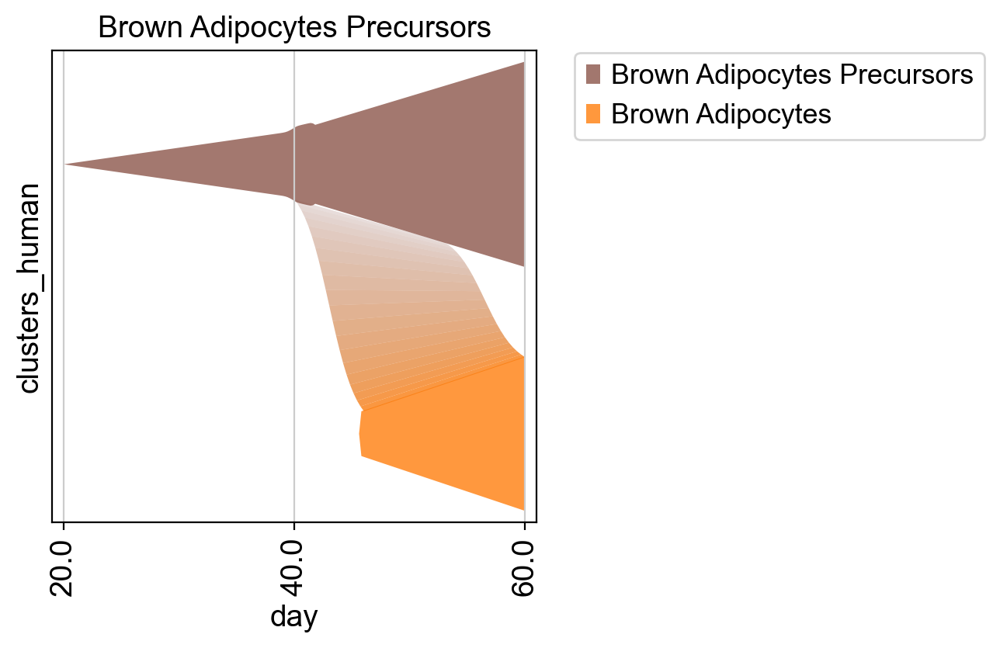

In [183]:
ax = wk.plot_single_flow(
    cluster_key="clusters_human",
    time_key="day",
    cluster="Brown Adipocytes Precursors",
    min_flow=0.2,
    xticks_step_size=1,
    show=False,
    dpi=100,
    ascending=False,
    clusters=adata.obs.clusters_human.cat.categories.to_list(),
    save='flow_brown_progenitors_human2.pdf',
    #time_points=[11.5,12.5,13.5,14.5],
)

# prettify the plot a bit, rotate x-axis tick labels
locs, labels = plt.xticks()
ax.set_xticks(locs)
ax.set_xticklabels(labels, rotation=90)

plt.show()